In [1]:
import datashader as ds
import xarray as xr
import numpy as np
from datashader.transfer_functions import shade
from datashader.transfer_functions import stack

### Read input xarray data

In [2]:
da = xr.open_rasterio('test_data/crater-lake-dem.tif')
# replace nodata value by np.nan
da.data[da.data == -32767.] = np.nan
# squeeze to 2 dims of ('x', 'y')
da = da.squeeze()
da

<xarray.DataArray (y: 4207, x: 4123)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)
Coordinates:
    band     int32 1
  * y        (y) float64 4.775e+06 4.775e+06 4.775e+06 ... 4.733e+06 4.733e+06
  * x        (x) float64 5.508e+05 5.509e+05 5.509e+05 ... 5.921e+05 5.921e+05
Attributes:
    transform:      (10.0, 0.0, 550845.0, 0.0, -10.0, 4775095.0)
    crs:            +init=epsg:26710
    res:            (10.0, 10.0)
    is_tiled:       0
    nodatavals:     (-32767.0,)
    scales:         (1.0,)
    offsets:        (0.0,)
    AREA_OR_POINT:  Area

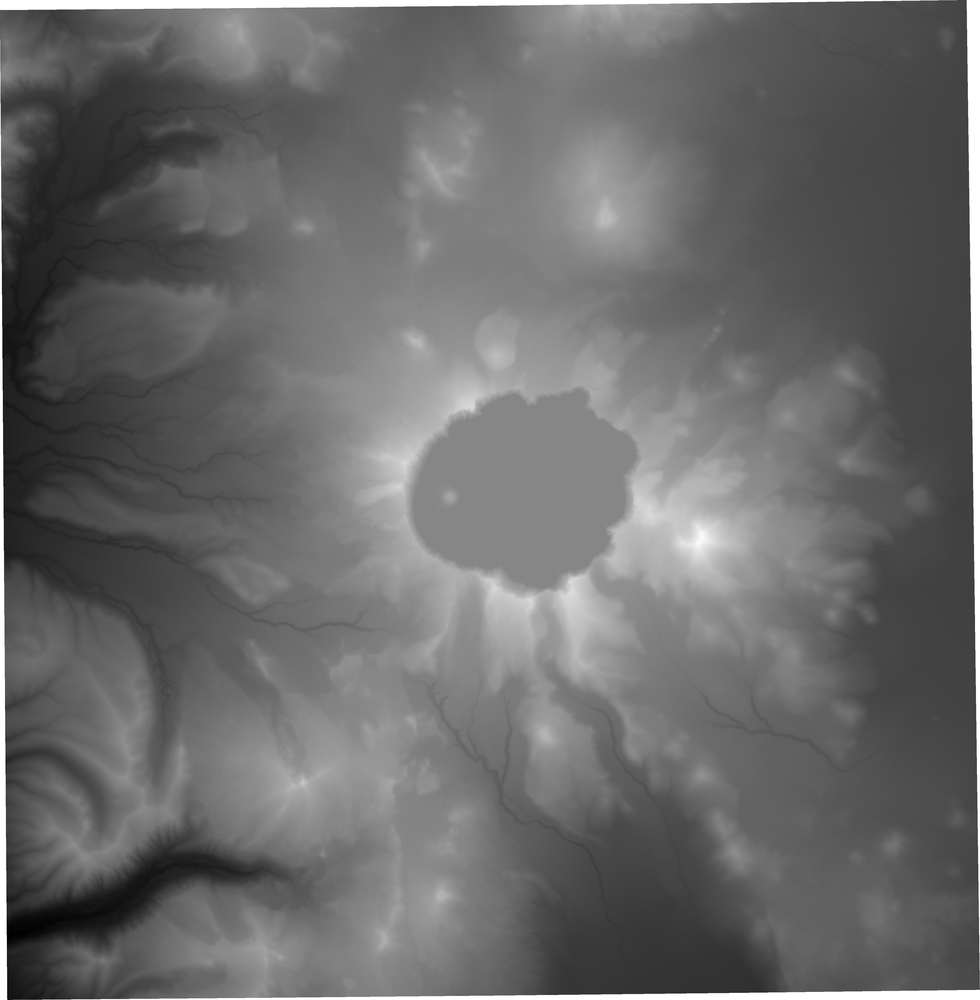

In [3]:
shade(da, cmap=['black', 'white'], how='linear')

### `slope` by `xrspatial`

In [4]:
from xrspatial import slope
xrspatial_slope = slope(da)

### `slope` by `QGIS`

In [5]:
# slope calculated by QGIS
qgis_slope = xr.open_rasterio('test_data/crater-lake-dem-slope-planar-degrees-z-1.tif')
# replace nodata value by np.nan
qgis_slope.data[qgis_slope.data == -3.4028234663852886e+38] = np.nan
# squeeze to 2 dims of ('x', 'y')
qgis_slope = qgis_slope.squeeze()
qgis_slope

<xarray.DataArray (y: 4207, x: 4123)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)
Coordinates:
    band     int32 1
  * y        (y) float64 4.775e+06 4.775e+06 4.775e+06 ... 4.733e+06 4.733e+06
  * x        (x) float64 5.508e+05 5.509e+05 5.509e+05 ... 5.921e+05 5.921e+05
Attributes:
    transform:      (10.0, 0.0, 550845.0, 0.0, -10.0, 4775095.0)
    crs:            +init=epsg:26710
    res:            (10.0, 10.0)
    is_tiled:       1
    nodatavals:     (-3.4028234663852886e+38,)
    scales:         (1.0,)
    offsets:        (0.0,)
    AREA_OR_POINT:  Area

### Compare results

In [6]:
# replace np.inf by np.nan
qgis_slope.data[~np.isfinite(qgis_slope.data)] = np.nan
xrspatial_slope.data[~np.isfinite(xrspatial_slope.data)] = np.nan

# calculate difference between result by xrspatial and result by QGIS
diff = xrspatial_slope.data - qgis_slope.data

#### The two package return same result

In [7]:
np.nanmax(diff), np.nanmin(diff), np.nansum(diff)

(0.0, 0.0, 0.0)

#### Visualize result by `xrspatial`

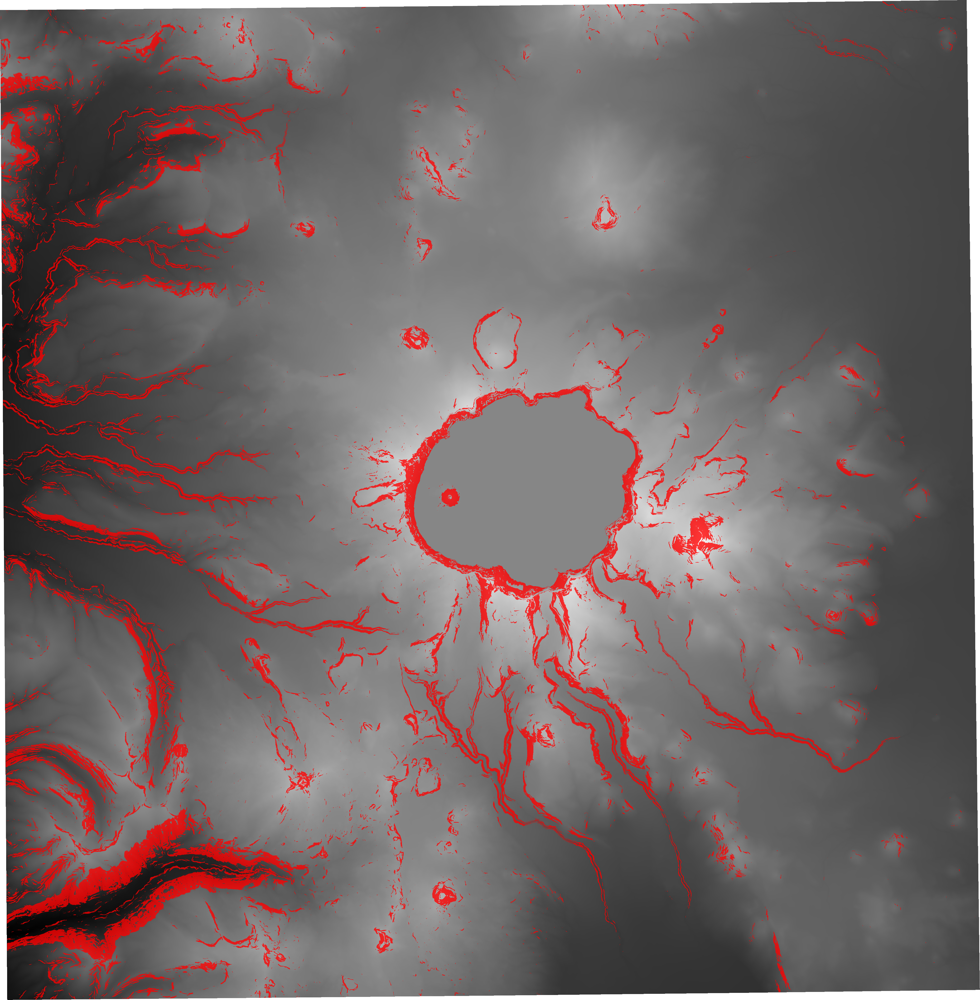

In [8]:
xrspatial_slope.data = np.where(np.logical_and(xrspatial_slope.data > 25, xrspatial_slope.data < 50), 1, np.nan)

stack(shade(da,              cmap=['black', 'white'], how='linear'),
      shade(xrspatial_slope, cmap='red',              how='linear', alpha=200))

#### Visualize result by `QGIS`

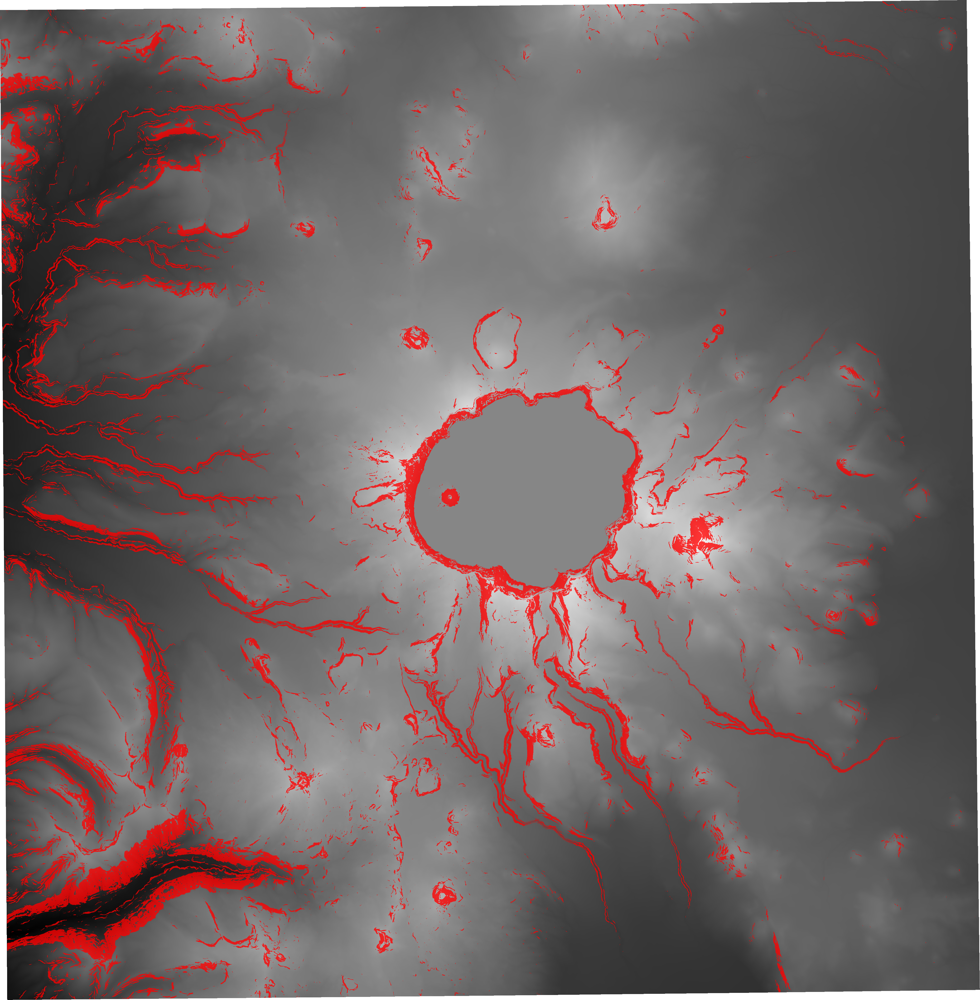

In [9]:
qgis_slope.data = np.where(np.logical_and(qgis_slope.data > 25, qgis_slope.data < 50), 1, np.nan)

stack(shade(da,         cmap=['black', 'white'], how='linear'),
      shade(qgis_slope, cmap='red',              how='linear', alpha=200))